## June 2024 bikeshare ridership analysis: ICONIC vs EFIT

### Import required packages

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import plotly.express as px

### Read data

In [2]:
# Load the CSV file into a DataFrame
file_path = 'data/ridership.csv'
df = pd.read_csv(file_path)

# Display the first few rows of the DataFrame
df.head()

,id,closed_status,duration,start_id,start_date,start_station_name,end_date,end_id,end_station_name,rider_type,...,start_time_only,start_time_seconds,end_date_only,end_time_only,end_time_seconds,day_of_week,start_lat,start_lon,end_lat,end_lon
0,29681508,NORMAL,62,7948,2024-06-30 03:16:00,Bathurst St / Housey St,2024-06-30 03:17:00,7948,Bathurst St / Housey St,MEMBER,...,03:16:00,11760,2024-06-30,03:17:00,11822,Sunday,43.637819,-79.400132,43.637819,-79.400132
1,29682786,NORMAL,876,7948,2024-06-30 08:18:00,Bathurst St / Housey St,2024-06-30 08:32:00,7938,Portland St / Wellington St W,MEMBER,...,08:18:00,29880,2024-06-30,08:32:00,30756,Sunday,43.637819,-79.400132,43.642902,-79.399370
2,29644869,NORMAL,766,7948,2024-06-28 16:04:00,Bathurst St / Housey St,2024-06-28 16:16:00,7927,Strachan Ave / East Liberty St - SMART,MEMBER,...,16:04:00,57840,2024-06-28,16:16:00,58606,Friday,43.637819,-79.400132,43.639065,-79.410810
3,29672434,NORMAL,1333,7948,2024-06-29 18:39:00,Bathurst St / Housey St,2024-06-29 19:02:00,7927,Strachan Ave / East Liberty St - SMART,MEMBER,...,18:39:00,67140,2024-06-29,19:02:00,68473,Saturday,43.637819,-79.400132,43.639065,-79.410810
4,29691472,NORMAL,1002,7948,2024-06-30 14:07:00,Bathurst St / Housey St,2024-06-30 14:24:00,7802,King St W / Jameson Ave - SMART,MEMBER,...,14:07:00,50820,2024-06-30,14:24:00,51822,Sunday,43.637819,-79.400132,43.637358,-79.436180


### Stats per bike model

In [3]:
# Calculate counts and percentages for 'bike_model'
bike_model_counts = df['bike_model'].value_counts()
bike_model_percentage = df['bike_model'].value_counts(normalize=True) * 100

average_duration = df.groupby('bike_model')['duration'].mean()
average_distance = df.groupby('bike_model')['distance_average'].mean()
average_elevation = df.groupby('bike_model')['elevation_delta_average'].mean()

bike_model_df = pd.DataFrame({
    'Count': bike_model_counts,
    'Percentage': bike_model_percentage.round(2),
    'Average Duration (seconds)': ((average_duration)).round(2),
    'Average Duration (minutes)': ((average_duration)/60).round(2),
    'Average Distance (meters)': average_distance.round(2),
    'Average Speed (meters/second)': (average_distance / (average_duration)).round(2),
    'Average Elevation Delta (meters)': average_elevation.round(2)
})

display(bike_model_df)

,Count,Percentage,Average Duration (seconds),Average Duration (minutes),Average Distance (meters),Average Speed (meters/second),Average Elevation Delta (meters)
bike_model,,,,,,,
EFIT,132763,17.39,1091.16,18.19,3390.23,3.11,-0.89
ICONIC,630662,82.61,1086.91,18.12,2768.05,2.55,-1.35


### Histograms of distance per bike model

EFIT bikes have a slightly higher density of farther trips as compared to ICONIC bikes.

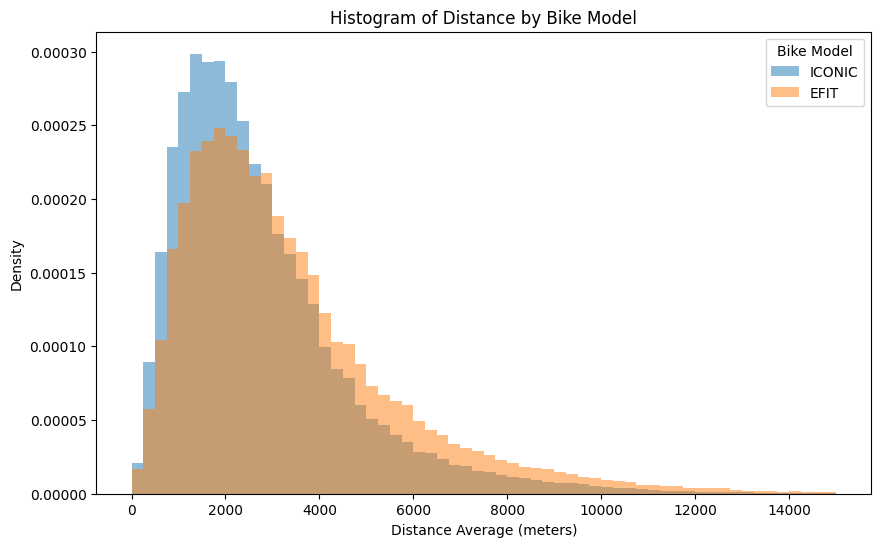

  bike_model         mean       median          std
0       EFIT  3390.234150  2806.437000  2391.327084
1     ICONIC  2768.053699  2303.089222  1944.192695


In [6]:
# Adjust min and max range of distance_average
min_distance = 0
max_distance = 15000

# Plotting
plt.figure(figsize=(10, 6))

# Filter for specific bike models
filtered_models = ['ICONIC', 'EFIT']
filtered_df = df[df['bike_model'].isin(filtered_models)]

# Apply the distance range filter
filtered_df = filtered_df[(filtered_df['distance_average'] >= min_distance) & (filtered_df['distance_average'] <= max_distance)]

# Get unique bike models from the filtered DataFrame
bike_models = filtered_df['bike_model'].unique()

# Create the histogram
for model in bike_models:
    subset = filtered_df[filtered_df['bike_model'] == model]
    plt.hist(subset['distance_average'], bins=60, density=True, alpha=0.5, label=model)

# Add labels and title
plt.xlabel('Distance Average (meters)')
plt.ylabel('Density')
plt.title('Histogram of Distance by Bike Model')
plt.legend(title='Bike Model')

# Show the plot
plt.show()

# Calculate statistics from filtered DataFrame
stats_filtered = filtered_df.groupby('bike_model')['distance_average'].agg(['mean', 'median', 'std']).reset_index()

# Calculate statistics from filtered DataFrame
stats_original_median = df.groupby('bike_model')['distance_average'].agg(['mean', 'median', 'std']).reset_index()
print(stats_original_median)

# Calculate min and max from original DataFrame
stats_original = df[df['bike_model'].isin(filtered_models)].groupby('bike_model')['distance_average'].agg(['min', 'max']).reset_index()

# Merge the statistics
stats = pd.merge(stats_filtered, stats_original, on='bike_model')

# Round statistics to 2 decimal places
stats = stats.round(2)

# Sort statistics to show ICONIC first
stats = stats.set_index('bike_model').loc[['ICONIC', 'EFIT']].reset_index()

# Display the statistics
# print(stats)

### Histograms of duration per bike model

Both EFIT and ICONIC bikes have rides with comparable durations.

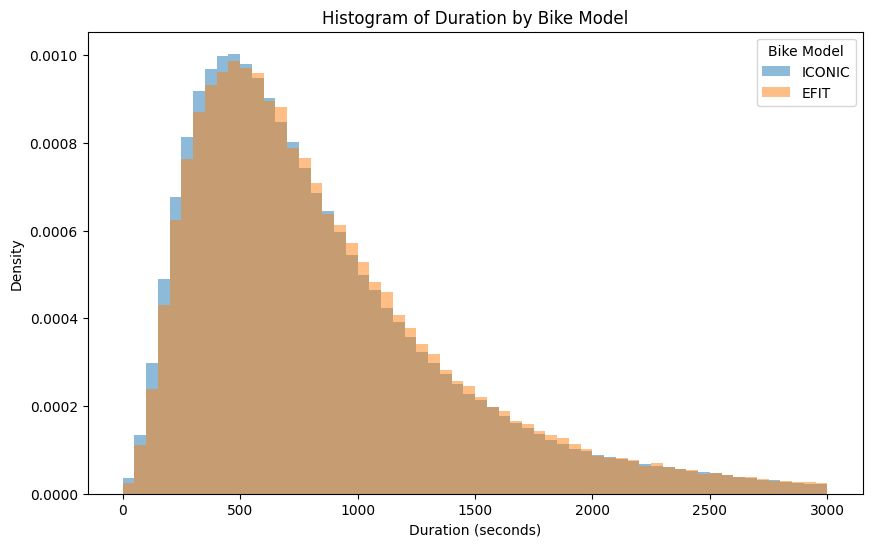

  bike_model         mean  median          std
0       EFIT  1091.158621   747.0  4482.349737
1     ICONIC  1086.905685   720.0  8078.082934


In [7]:
# Adjust min and max range of duration
min_duration = 0
max_duration = 3000

# Plotting
plt.figure(figsize=(10, 6))

# Filter for specific bike models
filtered_models = ['ICONIC', 'EFIT']
filtered_df = df[df['bike_model'].isin(filtered_models)]

# Apply the duration range filter
filtered_df = filtered_df[(filtered_df['duration'] >= min_duration) & (filtered_df['duration'] <= max_duration)]

# Get unique bike models from the filtered DataFrame
bike_models = filtered_df['bike_model'].unique()

# Create the histogram
for model in bike_models:
    subset = filtered_df[filtered_df['bike_model'] == model]
    plt.hist(subset['duration'], bins=60, density=True, alpha=0.5, label=model)

# Add labels and title
plt.xlabel('Duration (seconds)')
plt.ylabel('Density')
plt.title('Histogram of Duration by Bike Model')
plt.legend(title='Bike Model')

# Show the plot
plt.show()

# Calculate statistics from filtered DataFrame
stats_filtered = filtered_df.groupby('bike_model')['duration'].agg(['mean', 'median', 'std']).reset_index()
stats_unfiltered = df.groupby('bike_model')['duration'].agg(['mean', 'median', 'std']).reset_index()


# Calculate min and max from original DataFrame
stats_original = df[df['bike_model'].isin(filtered_models)].groupby('bike_model')['duration'].agg(['min', 'max']).reset_index()

# Merge the statistics
stats = pd.merge(stats_filtered, stats_original, on='bike_model')

# Round statistics to 2 decimal places
stats = stats.round(2)

# Sort statistics to show ICONIC first
stats = stats.set_index('bike_model').loc[['ICONIC', 'EFIT']].reset_index()

# Display the statistics
print(stats_unfiltered)

### Histograms of elevation delta per bike model

EFIT bikes have a higher density of steeper trips, whether going uphill or downhill, as compared to ICONIC bikes.

This finding could be a result of the distribution of EFIT bikes across the network. More research is needed to understand if certain bike models are taken to go uphill.

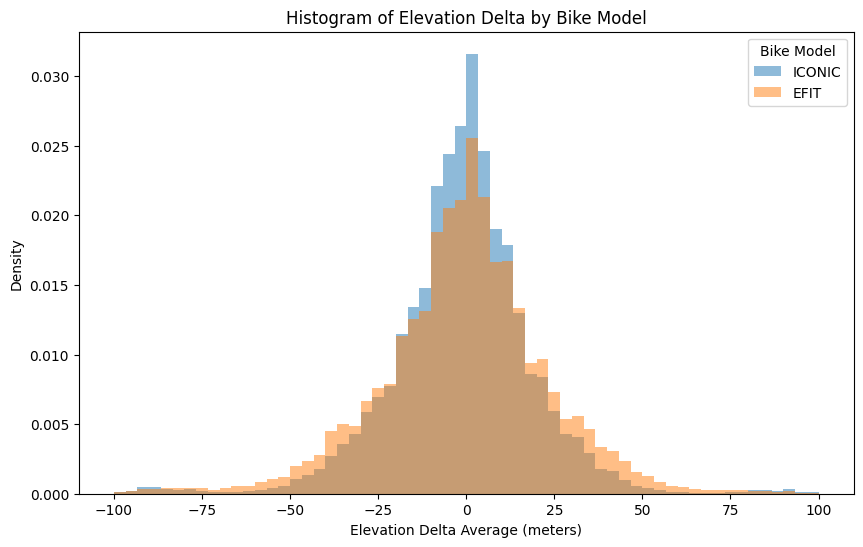

  bike_model  mean  median    std    min    max
0     ICONIC -1.18    -0.5  20.10 -179.5  182.0
1       EFIT -0.72     0.0  23.71 -173.0  179.5


In [6]:
# Adjust min and max range of elevation_delta_average
min_elevation_delta = -100
max_elevation_delta = 100

# Plotting
plt.figure(figsize=(10, 6))

# Filter for specific bike models
filtered_models = ['ICONIC', 'EFIT']
filtered_df = df[df['bike_model'].isin(filtered_models)]

# Apply the elevation delta range filter
filtered_df = filtered_df[(filtered_df['elevation_delta_average'] >= min_elevation_delta) & (filtered_df['elevation_delta_average'] <= max_elevation_delta)]

# Get unique bike models from the filtered DataFrame
bike_models = filtered_df['bike_model'].unique()

# Create the histogram
for model in bike_models:
    subset = filtered_df[filtered_df['bike_model'] == model]
    plt.hist(subset['elevation_delta_average'], bins=60, density=True, alpha=0.5, label=model)

# Add labels and title
plt.xlabel('Elevation Delta Average (meters)')
plt.ylabel('Density')
plt.title('Histogram of Elevation Delta by Bike Model')
plt.legend(title='Bike Model')

# Show the plot
plt.show()

# Calculate statistics from filtered DataFrame
stats_filtered = filtered_df.groupby('bike_model')['elevation_delta_average'].agg(['mean', 'median', 'std']).reset_index()

# Calculate min and max from original DataFrame
stats_original = df[df['bike_model'].isin(filtered_models)].groupby('bike_model')['elevation_delta_average'].agg(['min', 'max']).reset_index()

# Merge the statistics
stats = pd.merge(stats_filtered, stats_original, on='bike_model')

# Round statistics to 2 decimal places
stats = stats.round(2)

# Sort statistics to show ICONIC first
stats = stats.set_index('bike_model').loc[['ICONIC', 'EFIT']].reset_index()

# Display the statistics
print(stats)

### 24 hour frequency of trips trend across the entire month

Morning and evening rush hour peaks can be seen.

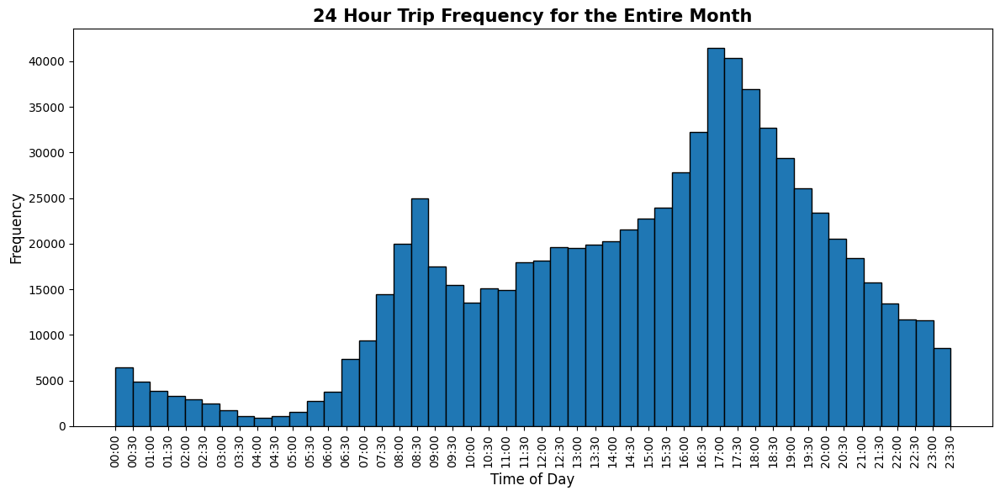

In [7]:
# Extract the start time in seconds from midnight
start_time_seconds = df['start_time_seconds']

# Convert start time in seconds to half-hours
half_hours = start_time_seconds // 1800  # 1800 seconds = 30 minutes

# Add half_hours to the DataFrame
df['half_hours'] = half_hours

# Create a histogram for the entire month
plt.figure(figsize=(12, 6))
plt.hist(df['half_hours'], bins=48, edgecolor='black')

# Set the labels for each half-hour
plt.xticks(ticks=np.arange(0, 48), labels=[f'{hour:02d}:{minute:02d}' for hour in range(24) for minute in (0, 30)], rotation=90)

# Set the title and labels
plt.title('24 Hour Trip Frequency for the Entire Month', fontsize=15, fontweight='bold')
plt.xlabel('Time of Day', fontsize=12)
plt.ylabel('Frequency', fontsize=12)

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()

### 24 hour frequency of trips by bike model

ICONIC bikes show more exaggerated frequency peaks during peak hours as compared to the EFIT bikes. This is due to the fact that there are more ICONIC bikes in the stock and they are more available than EFIT bikes.

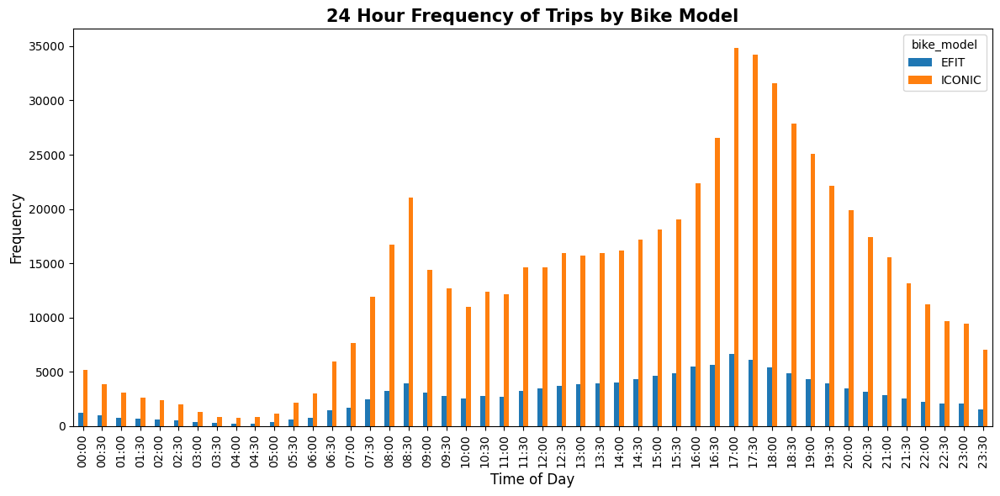

In [8]:
# Extract the start time in seconds from midnight
start_time_seconds = df['start_time_seconds']

# Convert start time in seconds to half-hours
half_hours = start_time_seconds // 1800  # 1800 seconds = 30 minutes

# Add half_hours to the DataFrame
df['half_hours'] = half_hours

# Group by bike_model and half_hours, then count occurrences
grouped = df.groupby(['bike_model', 'half_hours']).size().unstack(fill_value=0)

# Create a bar graph
grouped.T.plot(kind='bar', stacked=False, figsize=(12, 6))

# Set the labels for each half-hour
plt.xticks(ticks=np.arange(0, 48), labels=[f'{hour:02d}:{minute:02d}' for hour in range(24) for minute in (0, 30)], rotation=90)

# Set the title and labels
plt.title('24 Hour Frequency of Trips by Bike Model', fontsize=15, fontweight='bold')
plt.xlabel('Time of Day', fontsize=12)
plt.ylabel('Frequency', fontsize=12)

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()

### 24 hour density of trips per bike model

EFITE and ICONIC bikes share similar trip frequencies relative to their respective share in the total bike stock. However, during off-peak hours the EFIT bikes are taken more relative to their stock than regular ICONIC bikes. 

This may be due to the availability of EFIT bikes during off-peak periods, where riders consistently take the EFIT bikes based on their availibility over the ICONIC bikes.

When EFIT bikes are available, riders take them.

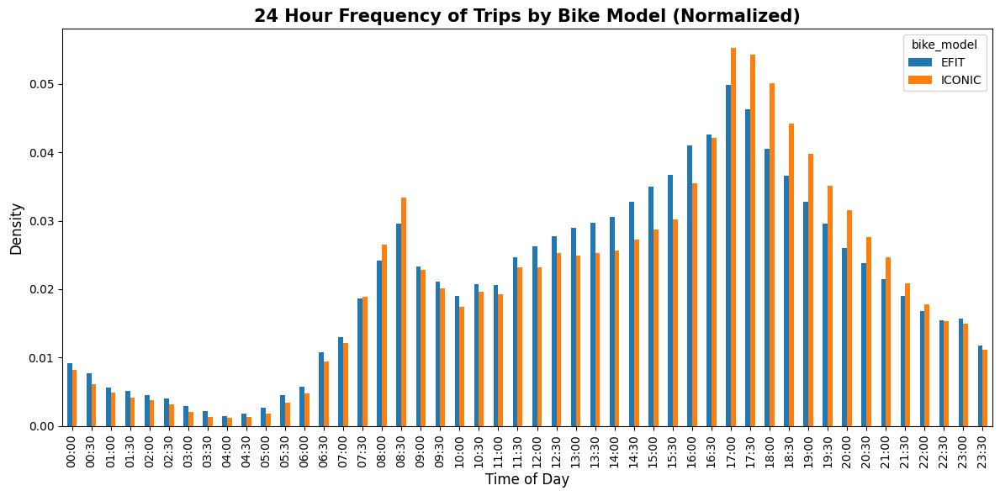

In [9]:
# Extract the start time in seconds from midnight
start_time_seconds = df['start_time_seconds']

# Convert start time in seconds to half-hours
half_hours = start_time_seconds // 1800  # 1800 seconds = 30 minutes

# Add half_hours to the DataFrame
df['half_hours'] = half_hours

# Group by bike_model and half_hours, then count occurrences
grouped = df.groupby(['bike_model', 'half_hours']).size().unstack(fill_value=0)

# Normalize the counts to represent density
normalized_grouped = grouped.div(grouped.sum(axis=1), axis=0)

# Create a bar graph with normalized values
normalized_grouped.T.plot(kind='bar', stacked=False, figsize=(12, 6))

# Set the labels for each half-hour
plt.xticks(ticks=np.arange(0, 48), labels=[f'{hour:02d}:{minute:02d}' for hour in range(24) for minute in (0, 30)], rotation=90)

# Set the title and labels
plt.title('24 Hour Frequency of Trips by Bike Model (Normalized)', fontsize=15, fontweight='bold')
plt.xlabel('Time of Day', fontsize=12)
plt.ylabel('Density', fontsize=12)

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()

### Radial plots, trips started for each day of the week

Monday to Thrusday show the morning and evening rush hour peaks. 

The rush hour peaks are less exaggerated on Friday. A result of the 4-day work week?

Saturday and Sunday do not show rush hour peaks. Instead, trips seem to be taken consistently throughout the day, as well as some nocturnal trips from weekend nightlife.



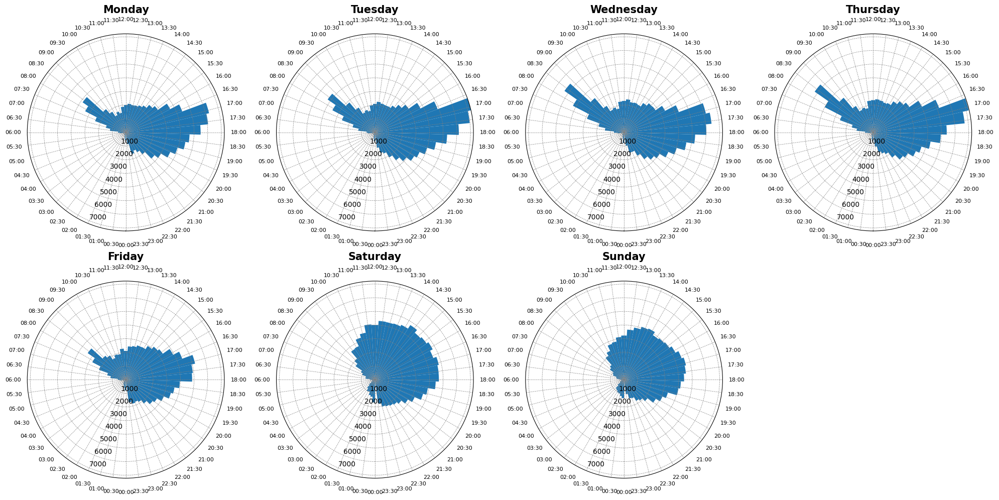

In [10]:
# Extract the start time in seconds from midnight
start_time_seconds = df['start_time_seconds']

# Convert start time in seconds to half-hours
half_hours = start_time_seconds // 1800  # 1800 seconds = 30 minutes

# Add half_hours to the DataFrame
df['half_hours'] = half_hours

# Convert half-hours to radians
df['angles'] = np.deg2rad(df['half_hours'] * 7.5)  # 360 degrees / 48 half-hours = 7.5 degrees per half-hour

# Extract day of the week
df['day_of_week'] = pd.to_datetime(df['start_date']).dt.day_name().str.lower()

# Days of the week
days = ['monday', 'tuesday', 'wednesday', 'thursday', 'friday', 'saturday', 'sunday']

# Calculate the maximum count of any bin across all days
max_count = 0
for day in days:
    day_data = df[df['day_of_week'] == day]
    angles = day_data['angles']
    counts, _ = np.histogram(angles, bins=48)
    max_count = max(max_count, counts.max())

# Create a 2x4 grid of subplots
fig, axs = plt.subplots(2, 4, subplot_kw={'projection': 'polar'}, figsize=(20, 10))

# Flatten the array of axes for easy iteration
axs = axs.flatten()

# Create a radial histogram for each day of the week
for i, day in enumerate(days):
    day_data = df[df['day_of_week'] == day]
    angles = day_data['angles']

    # Plot the histogram
    axs[i].hist(angles, bins=48, edgecolor='none', linewidth=1.2)

    # Set the labels for each half-hour
    axs[i].set_xticks(np.deg2rad(np.arange(0, 360, 7.5)))
    axs[i].set_xticklabels([f'{hour:02d}:{minute:02d}' for hour in range(24) for minute in (0, 30)], fontsize=8)

    # Set the starting angle to 180 degrees to place 12:00 at the top
    axs[i].set_theta_zero_location('S')

    # Set the direction to clockwise
    axs[i].set_theta_direction(-1)

    # Set the title
    axs[i].set_title(f'{day.capitalize()}', fontsize=15, fontweight='bold')

    # Customize the grid and radial ticks
    axs[i].grid(color='gray', linestyle='--', linewidth=0.5)
    axs[i].yaxis.set_tick_params(labelsize=10)
    axs[i].xaxis.set_tick_params(pad=10)

    # Set the y-axis limit to the maximum count
    axs[i].set_ylim(0, max_count)

# Remove the last subplot (empty subplot)
fig.delaxes(axs[-1])

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()

When down by density of trips per bike model, we see a similar finding to the 24 hour finding, where EFIT bikes are taken during off-peak.

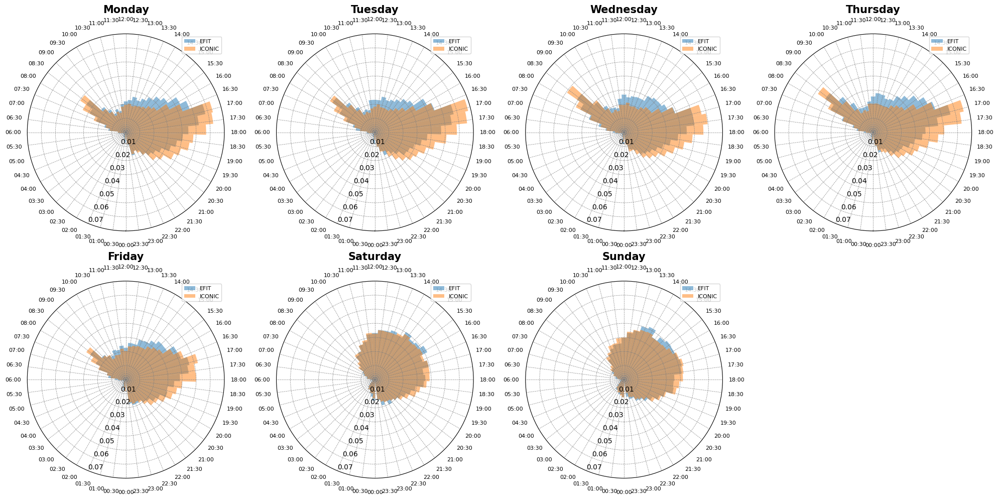

In [11]:
# Extract the start time in seconds from midnight
start_time_seconds = df['start_time_seconds']

# Convert start time in seconds to half-hours
half_hours = start_time_seconds // 1800  # 1800 seconds = 30 minutes

# Add half_hours to the DataFrame
df['half_hours'] = half_hours

# Convert half-hours to radians
df['angles'] = np.deg2rad(df['half_hours'] * 7.5)  # 360 degrees / 48 half-hours = 7.5 degrees per half-hour

# Extract day of the week
df['day_of_week'] = pd.to_datetime(df['start_date']).dt.day_name().str.lower()

# Days of the week
days = ['monday', 'tuesday', 'wednesday', 'thursday', 'friday', 'saturday', 'sunday']

# Filter the DataFrame for the specific bike models
bike_models = ['EFIT', 'ICONIC']
df_filtered = df[df['bike_model'].isin(bike_models)]

# Calculate the maximum count of any bin across all days and the specified bike models
max_count = 0
for day in days:
    for model in bike_models:
        day_data = df_filtered[(df_filtered['day_of_week'] == day) & (df_filtered['bike_model'] == model)]
        angles = day_data['angles']
        counts, _ = np.histogram(angles, bins=48)
        max_count = max(max_count, counts.max())

# Create a 2x4 grid of subplots
fig, axs = plt.subplots(2, 4, subplot_kw={'projection': 'polar'}, figsize=(20, 10))

# Flatten the array of axes for easy iteration
axs = axs.flatten()

# Create a radial histogram for each day of the week
for i, day in enumerate(days):
    for model in bike_models:
        day_data = df_filtered[(df_filtered['day_of_week'] == day) & (df_filtered['bike_model'] == model)]
        angles = day_data['angles']

        # Plot the normalized histogram
        counts, bins = np.histogram(angles, bins=48)
        normalized_counts = counts / counts.sum()  # Normalize counts
        axs[i].hist(bins[:-1], bins, weights=normalized_counts, alpha=0.5, label=model, edgecolor='none', linewidth=1.2)

    # Set the labels for each half-hour
    axs[i].set_xticks(np.deg2rad(np.arange(0, 360, 7.5)))
    axs[i].set_xticklabels([f'{hour:02d}:{minute:02d}' for hour in range(24) for minute in (0, 30)], fontsize=8)

    # Set the starting angle to 180 degrees to place 12:00 at the top
    axs[i].set_theta_zero_location('S')

    # Set the direction to clockwise
    axs[i].set_theta_direction(-1)

    # Set the title
    axs[i].set_title(f'{day.capitalize()}', fontsize=15, fontweight='bold')

    # Customize the grid and radial ticks
    axs[i].grid(color='gray', linestyle='--', linewidth=0.5)
    axs[i].yaxis.set_tick_params(labelsize=10)
    axs[i].xaxis.set_tick_params(pad=10)

    # Set the y-axis limit to the maximum count
    axs[i].set_ylim(0, .07)  # Since counts are normalized, the max is 1

    # Add legend
    axs[i].legend(loc='upper right', fontsize=8)

# Remove the last subplot (empty subplot)
fig.delaxes(axs[-1])

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()

### Extra: Trend for the month of June 2024

A weekly pattern is visible throughout the month.

In [12]:
# Convert the 'start_date' column to datetime
df['start_date'] = pd.to_datetime(df['start_date'])

# Create hourly bins
min_date = df['start_date'].min()
max_date = df['start_date'].max()
bins = pd.date_range(start=min_date, end=max_date, freq='h')

# Plot the histogram with hourly bins using Plotly
fig = px.histogram(df, x='start_date', nbins=len(bins))
fig.update_layout(
    title='Histogram of Trips for June 2024 (Hourly Bins)',
    title_x=0.5,
    xaxis_title='Date',
    yaxis_title='Frequency',
    bargap=0.1,
    width=850,
    xaxis=dict(
        tickformat='%Y-%m-%d (%A)',  # Format x-axis to show dates and days of the week
        tickangle=90,  # Rotate x-axis labels by 90 degrees
        dtick=86400000,  # Show a label for each day
        tickfont=dict(size=10)  # Set font size for x-axis labels
    ),
    yaxis=dict(
        tickfont=dict(size=10)  # Set font size for y-axis labels
    )
)
fig.show()